In [1]:
%pip install ultralytics dill opencv-python matplotlib facenet-pytorch mtcnn

Note: you may need to restart the kernel to use updated packages.


ぼかし画像を保存しました: asunaro1_blur_faces.jpg 


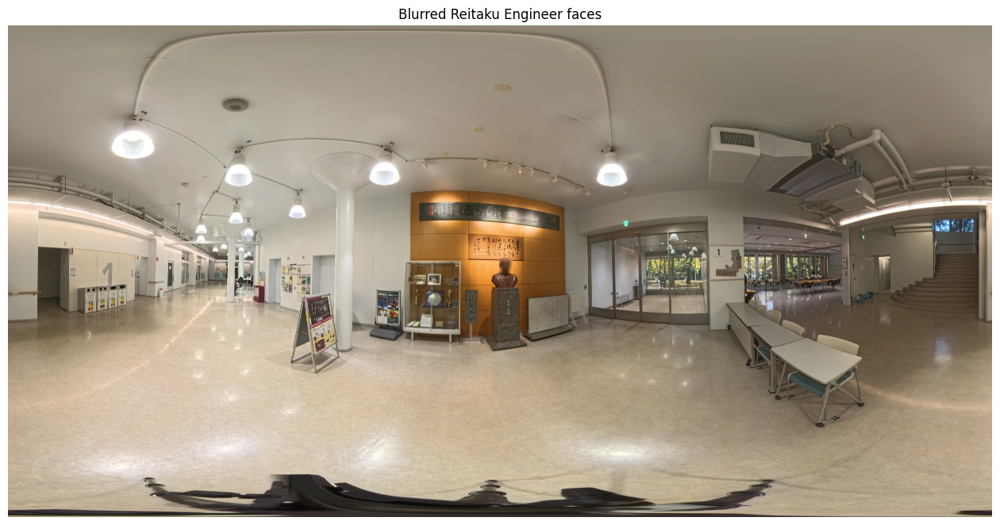

ぼかし画像を保存しました: hashi_blur_faces.jpg 


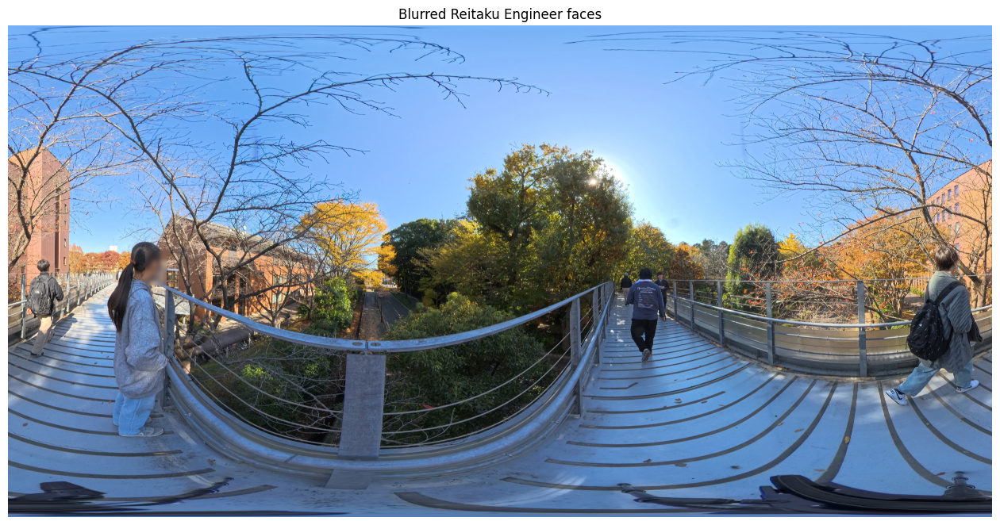

ぼかし画像を保存しました: hiiragi_1_blur_faces.jpg 


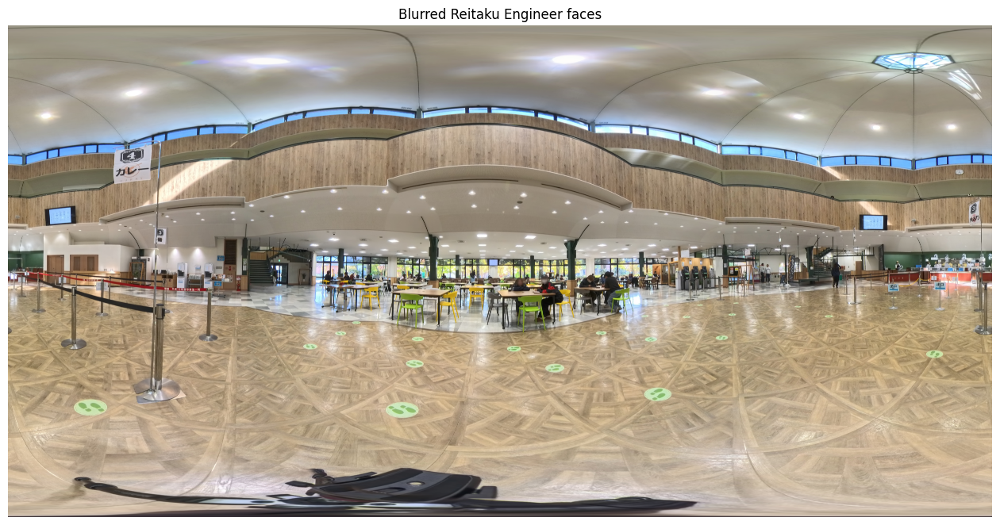

ぼかし画像を保存しました: hiiragi_2_blur_faces.jpg 


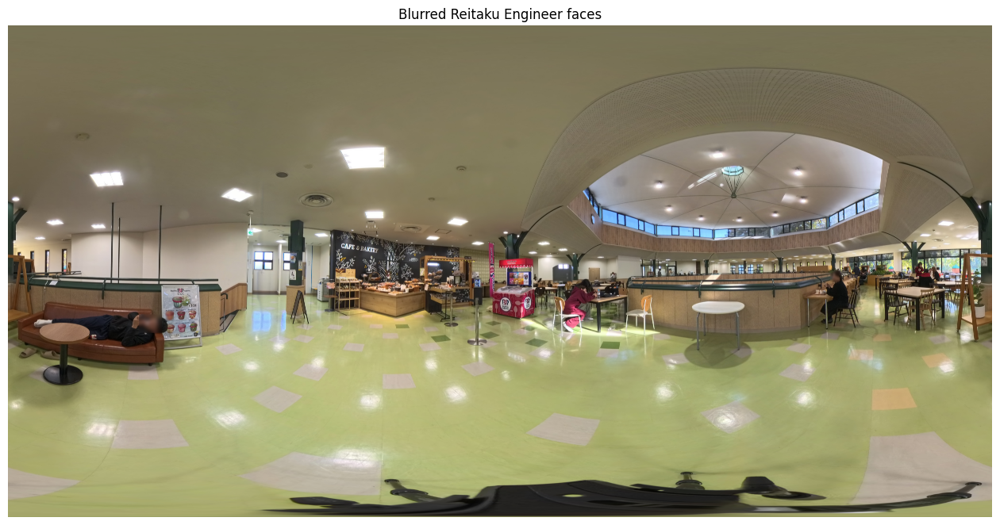

ぼかし画像を保存しました: iArena_blur_faces.jpg 


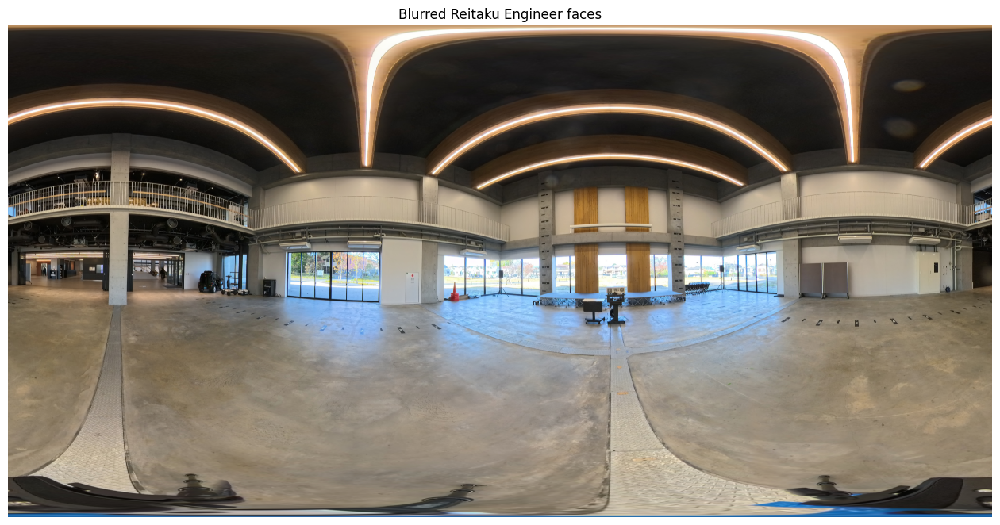

ぼかし画像を保存しました: iFloor_blur_faces.jpg 


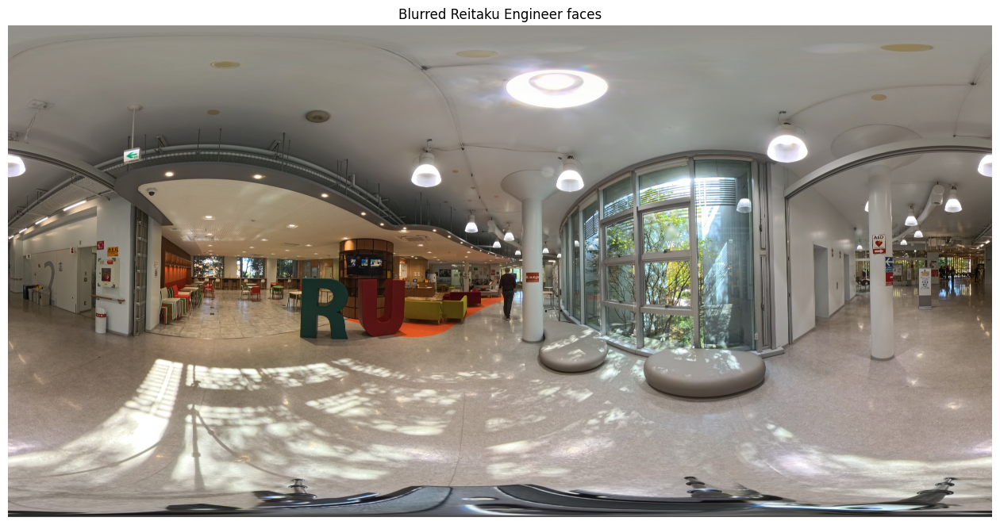

ぼかし画像を保存しました: iStudio_blur_faces.jpg 


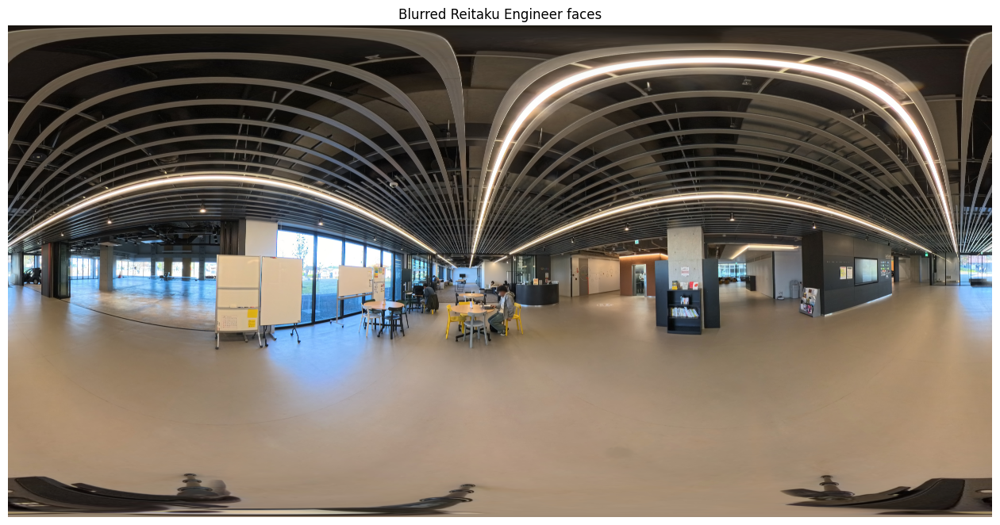

ぼかし画像を保存しました: kaede_career_blur_faces.jpg 


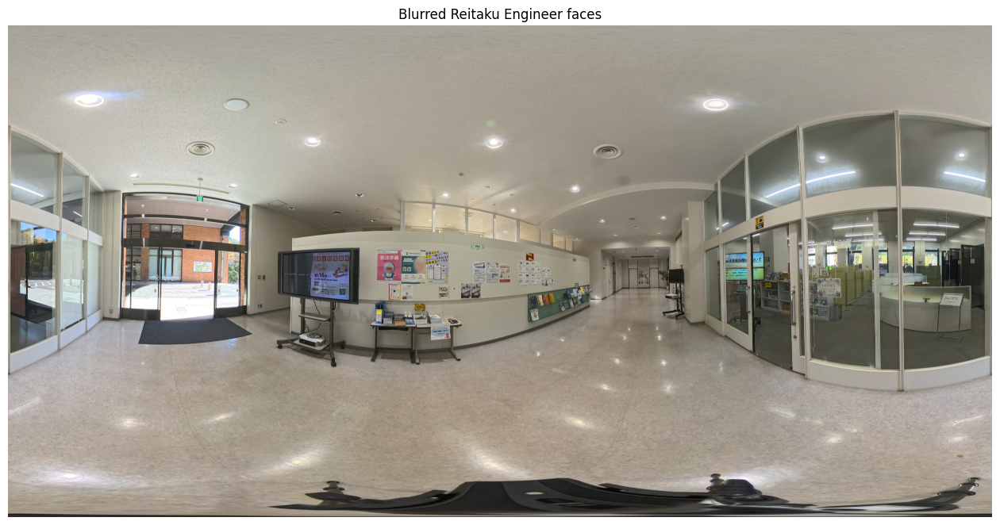

ぼかし画像を保存しました: kaede_front_blur_faces.jpg 


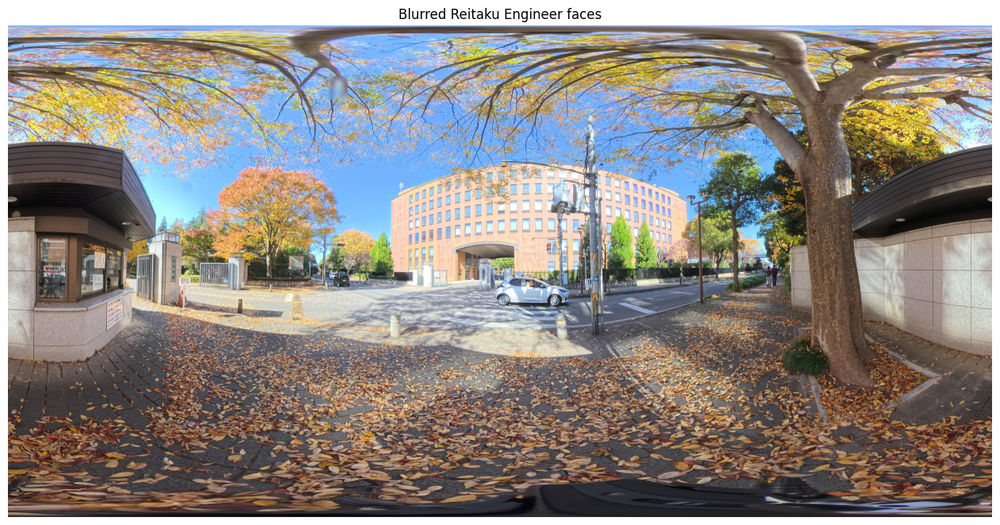

ぼかし画像を保存しました: kaede_student_blur_faces.jpg 


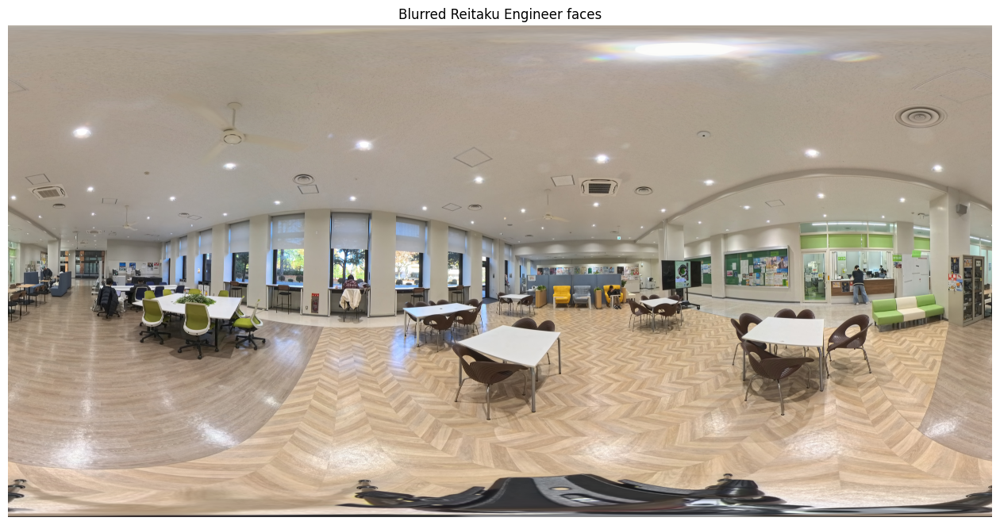

ぼかし画像を保存しました: kennkyuutou_mae_blur_faces.jpg 


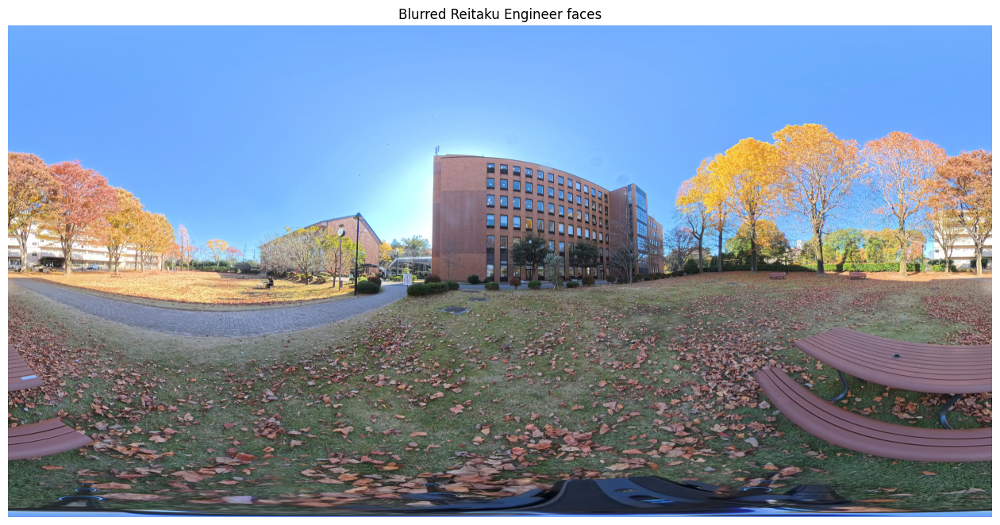

ぼかし画像を保存しました: namikimiti_blur_faces.jpg 


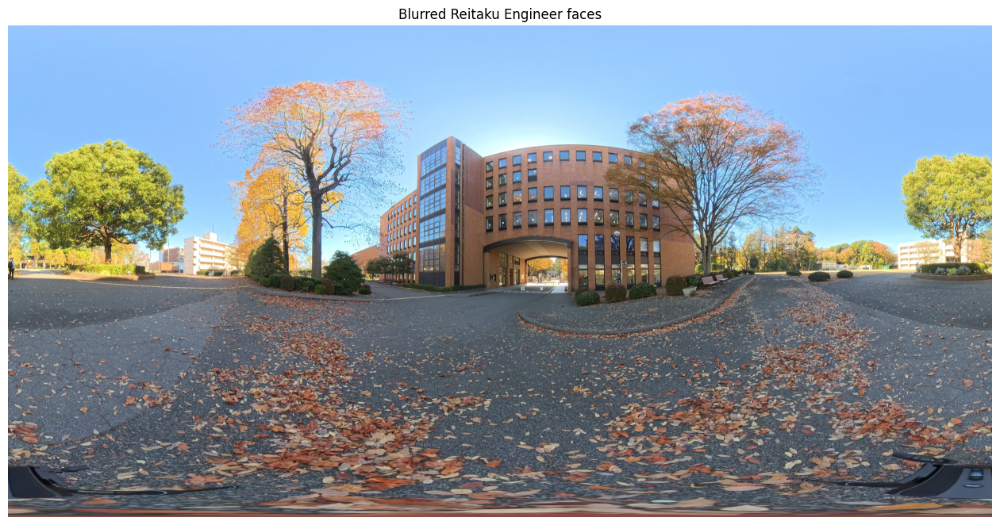

ぼかし画像を保存しました: satsuki_out_blur_faces.jpg 


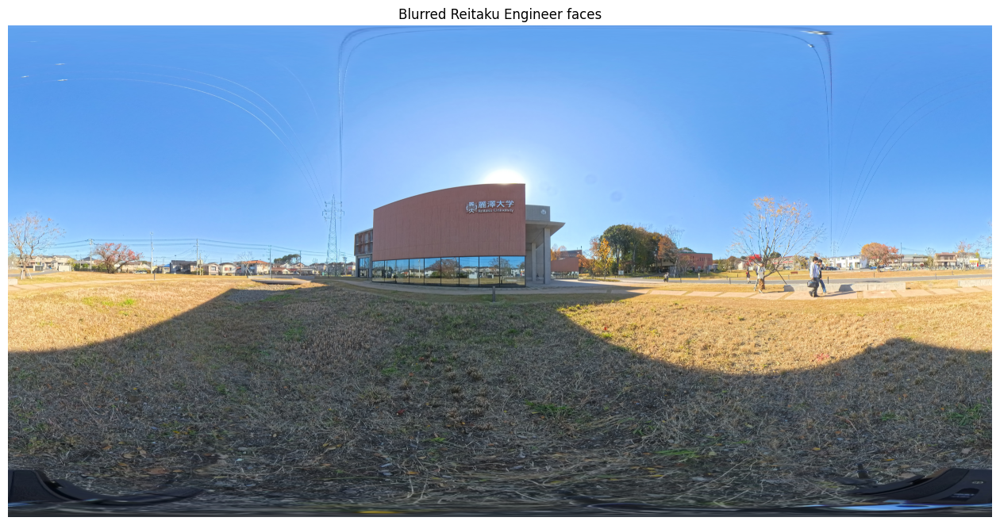

ぼかし画像を保存しました: tosyokann_nai_blur_faces.jpg 


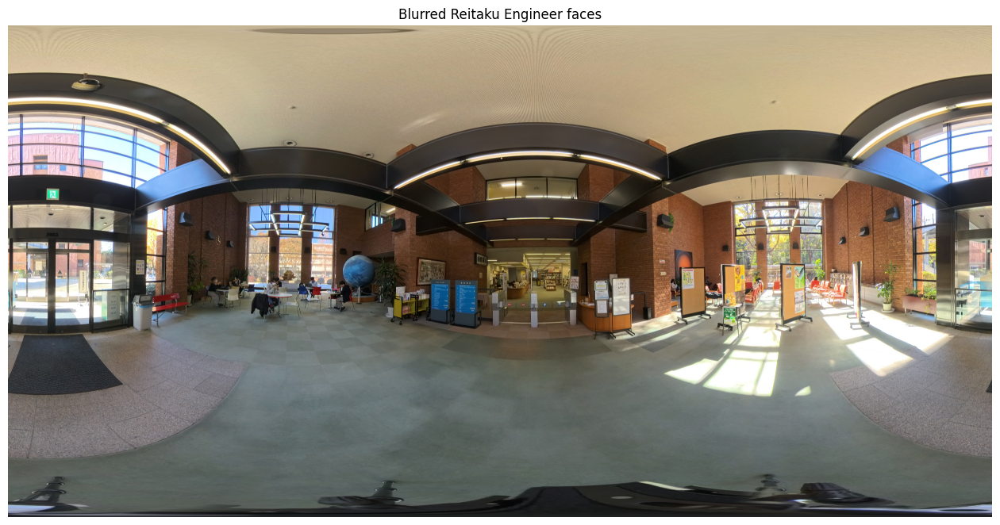

ぼかし画像を保存しました: tosyokann_soto_blur_faces.jpg 


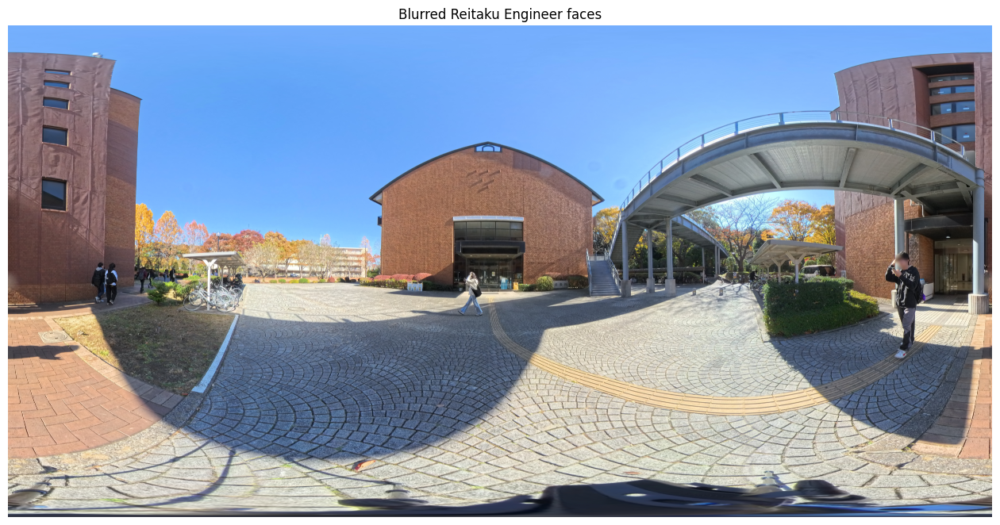

In [12]:
import cv2
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt

def blur_faces(image_path):
    """
    blur_faces(image_path): YOLO で検出して顔領域を強くぼかす関数。
    引数は image_path のみ（文字列または Path）。
    """
    image_path = Path(image_path)
    model_path = Path('yolov8m-face.pt')
    from ultralytics import YOLO
    model = YOLO(model_path)
    result = model.predict(source=str(image_path), conf=0.25, verbose=False, imgsz=1280)[0]

    # 画像を読み込む
    img = cv2.imread(str(image_path))
    if img is None:
        raise FileNotFoundError(f'Image not found: {image_path}')
    h_img, w_img = img.shape[:2]
    out = img.copy()  # 出力用にコピー
# 検出された顔ごとに処理
    for box in result.boxes.xyxy.cpu().numpy():
        x1, y1, x2, y2 = map(int, box)
        if x2 <= x1 or y2 <= y1:
            continue  # 異常なボックスはスキップ
        w = x2 - x1
        h = y2 - y1
        pad = int(max(w, h) * 0.2)  # 顔の周囲に20%のバッファを追加
        x1p = max(0, x1 - pad)
        y1p = max(0, y1 - pad)
        x2p = min(w_img, x2 + pad)
        y2p = min(h_img, y2 + pad)
        face = out[y1p:y2p, x1p:x2p]  # 顔領域を切り出し
        if face.size == 0:
            continue  # 領域が空ならスキップ
        # ブラーのカーネルサイズを決定（顔サイズに応じて大きめに設定）
        k = max(5, min(face.shape[0], face.shape[1]) // 2)
        if k % 2 == 0:
            k += 1  # カーネルサイズは奇数にする必要あり
        # 2回ガウシアンブラーをかけて強くぼかす
        face_blur = cv2.GaussianBlur(face, (k, k), 0)
        face_blur = cv2.GaussianBlur(face_blur, (k, k), 0)
        out[y1p:y2p, x1p:x2p] = face_blur  # ぼかした顔を元画像に貼り付け
# 画像全体を2倍にアップスケールして高解像度で保存
    up = cv2.resize(out, (w_img*2, h_img*2), interpolation=cv2.INTER_CUBIC)
    output_path = image_path.with_name(image_path.stem + '_blur_faces.jpg')
    cv2.imwrite(str(output_path), up)
    print(f'ぼかし画像を保存しました: {output_path} ')

    # 結果を表示
    plt.figure(figsize=(16,16))
    plt.imshow(cv2.cvtColor(up, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Blurred Reitaku Engineer faces')
    plt.show()

# 関数を実行（reitaku.jpg を引数として渡す）
blur_faces('asunaro1.jpg')
blur_faces('hashi.jpg')
blur_faces('hiiragi_1.jpg')
blur_faces('hiiragi_2.jpg')
blur_faces('iArena.jpg')
blur_faces('iFloor.jpg')
blur_faces('iStudio.jpg')
blur_faces('kaede_career.jpg')
blur_faces('kaede_front.jpg')
blur_faces('kaede_student.jpg')
blur_faces('kennkyuutou_mae.jpg')
blur_faces('namikimiti.jpg')
blur_faces('satsuki_out.jpg')
blur_faces('tosyokann_nai.jpg')
blur_faces('tosyokann_soto.jpg')